# Vehicle Detection Project

The goals / steps of this project are the following:

* Perform a Histogram of Oriented Gradients (HOG) feature extraction on a labeled training set of images and train a classifier Linear SVM classifier
* Apply a color transform and append binned color features, as well as histograms of color, to your HOG feature vector. 
* Normalize features and randomize a selection for training and testing.
* Implement a sliding-window technique and use your trained classifier to search for vehicles in images.
* Use HOG subsampling slide window to speed up processing.
* Run pipeline on a video stream (start with the test_video.mp4 and later implement on full project_video.mp4) and create a heat map of recurring detections frame by frame to reject outliers and follow detected vehicles.
* Estimate a bounding box for vehicles detected.


In [159]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import cv2
import glob
import time
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
from skimage.feature import hog
# NOTE: the next import is only valid for scikit-learn version <= 0.17
# for scikit-learn >= 0.18 use:
from sklearn.model_selection import train_test_split
# from sklearn.cross_validation import train_test_split
import pickle

## Define HOG Feature function

In [160]:
# Define a function to return HOG features and visualization
def get_hog_features(img, orient, pix_per_cell, cell_per_block,
                        vis=False, feature_vec=True):
    # Call with two outputs if vis==True
    if vis == True:
        features, hog_image = hog(img, block_norm='L1', orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=True,
                                  visualise=vis, feature_vector=feature_vec)
        return features, hog_image
    # Otherwise call with one output
    else:
        features = hog(img, block_norm='L1', orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=True,
                       visualise=vis, feature_vector=feature_vec)
        return features



## Spatial Binning of Color Features

In [161]:
def bin_spatial(img, size=(32, 32)):
    # Use cv2.resize().ravel() to create the feature vector
    features = cv2.resize(img, size).ravel()
    # Return the feature vector
    return features

## Color Histogram Features

In [162]:
# Define a function to compute color histogram features
# NEED TO CHANGE bins_range if reading .png files with mpimg!
def color_hist(img, nbins=32, bins_range=(0, 256)):
    # Compute the histogram of the color channels separately
    channel1_hist = np.histogram(img[:, :, 0], bins=nbins, range=bins_range)
    channel2_hist = np.histogram(img[:, :, 1], bins=nbins, range=bins_range)
    channel3_hist = np.histogram(img[:, :, 2], bins=nbins, range=bins_range)
    # Concatenate the histograms into a single feature vector
    hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
    # Return the individual histograms, bin_centers and feature vector
    return hist_features

### Function Extract Features (from file)

In [163]:
# Have this function call bin_spatial() and color_hist()
# scale_normalize convert image data to 0-1.  Only need if image is jpeg
# 
def extract_features(imgs, color_space='BGR', spatial_size=(32, 32),
                     hist_bins=32, orient=9,
                     pix_per_cell=8, cell_per_block=2, hog_channel=0,
                     spatial_feat=True, hist_feat=True, hog_feat=True):
    # Create a list to append feature vectors to
    features = []
    # Iterate through the list of images
    for file in imgs:
        file_features = []
        # Read in each one by one
        image = cv2.imread(file)
            
        # apply color conversion if other than 'RGB'
        if color_space != 'BGR':
            if color_space == 'HSV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
            elif color_space == 'LUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_BGR2LUV)
            elif color_space == 'HLS':
                feature_image = cv2.cvtColor(image, cv2.COLOR_BGR2HLS)
            elif color_space == 'YUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_BGR2YUV)
            elif color_space == 'YCrCb':
                feature_image = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
        else:
            feature_image = np.copy(image)

        if spatial_feat == True:
            spatial_features = bin_spatial(feature_image, size=spatial_size)
            file_features.append(spatial_features)
        if hist_feat == True:
            # Apply color_hist()
            hist_features = color_hist(feature_image, nbins=hist_bins)
            file_features.append(hist_features)
        if hog_feat == True:
            # Call get_hog_features() with vis=False, feature_vec=True
            if hog_channel == 'ALL':
                hog_features = []
                for channel in range(feature_image.shape[2]):
                    hog_features.append(get_hog_features(feature_image[:, :, channel],
                                                         orient, pix_per_cell, cell_per_block,
                                                         vis=False, feature_vec=True))
                hog_features = np.ravel(hog_features)
            else:
                hog_features = get_hog_features(feature_image[:, :, hog_channel], orient,
                                                pix_per_cell, cell_per_block, vis=False, feature_vec=True)
            # Append the new feature vector to the features list
            file_features.append(hog_features)
        features.append(np.concatenate(file_features))
    # Return list of feature vectors
    return features


## Use StandardScaler to normalize HOG and color feature values


In [164]:
# Test get_hog_features
# Divide up into cars and notcars
images = glob.glob('smallest/*.jpeg')
cars = []
notcars = []
for image in images:
    if 'image' in image or 'extra' in image:
        notcars.append(image)
    else:
        cars.append(image)

# Reduce the sample size because HOG features are slow to compute
sample_size = 500
cars = cars[0:sample_size]
notcars = notcars[0:sample_size]

###  Tweak these parameters and see how the results change.
colorspace = 'YUV' # Can be RGB, HSV, LUV, HLS, YUV, YCrCb
orient = 9
pix_per_cell = 8
cell_per_block = 2
hog_channel = "ALL" # Can be 0, 1, 2, or "ALL"

spatial_size = (32, 32)
hist_bins = 32
use_spatial_feat=True
use_hist_feat=True
use_hog_feat=True

t=time.time()
# the test data set is jpeg, need to scale normalize
car_features = extract_features(cars, 
                        spatial_size=spatial_size,
                        hist_bins=hist_bins,
                        color_space=colorspace, orient=orient,
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial_feat=use_spatial_feat, hist_feat=use_hist_feat, hog_feat=use_hog_feat)
                        
notcar_features = extract_features(notcars, 
                        spatial_size=spatial_size,
                        hist_bins=hist_bins,
                        color_space=colorspace, orient=orient,
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial_feat=use_spatial_feat, hist_feat=use_hist_feat, hog_feat=use_hog_feat)
                        
t2 = time.time()
print(round(t2-t, 2), 'Seconds to extract HOG features...')
# Create an array stack of feature vectors
X = np.vstack((car_features, notcar_features)).astype(np.float64)
# Fit a per-column scaler
X_scaler = StandardScaler().fit(X)
# Apply the scaler to X
scaled_X = X_scaler.transform(X)

# Define the labels vector
y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))


# Split up data into randomized training and test sets
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(
    scaled_X, y, test_size=0.2, random_state=rand_state)

print('Using:',orient,'orientations',pix_per_cell,
    'pixels per cell and', cell_per_block,'cells per block')
print('Feature vector length:', len(X_train[0]))
# Use a linear SVC
svc = LinearSVC()
# Check the training time for the SVC
t=time.time()
svc.fit(X_train, y_train)
t2 = time.time()
print(round(t2-t, 2), 'Seconds to train SVC...')
# Check the score of the SVC
print('Test Accuracy of SVC = ', round(svc.score(X_test, y_test), 4))
# Check the prediction time for a single sample
t=time.time()
n_predict = 10
print('My SVC predicts: ', svc.predict(X_test[0:n_predict]))
print('For these',n_predict, 'labels: ', y_test[0:n_predict])
t2 = time.time()
print(round(t2-t, 5), 'Seconds to predict', n_predict,'labels with SVC')

c:\users\michael tien\miniconda3\lib\site-packages\skimage\feature\_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


5.56 Seconds to extract HOG features...
Using: 9 orientations 8 pixels per cell and 2 cells per block
Feature vector length: 8460
0.47 Seconds to train SVC...
Test Accuracy of SVC =  0.985
My SVC predicts:  [ 0.  0.  0.  0.  1.  0.  0.  0.  1.  1.]
For these 10 labels:  [ 0.  0.  0.  0.  1.  0.  0.  0.  1.  1.]
0.001 Seconds to predict 10 labels with SVC


### *Save Test SVC and Hyper parameters*

In [165]:
# save result and parameters
dict_pickle = {
    "svc": svc,
    "scaler": X_scaler,
    "colorspace":colorspace,
    "orient": orient,
    "pix_per_cell": pix_per_cell,
    "cell_per_block":cell_per_block,
    "hog_channel":hog_channel,
    "spatial_size": spatial_size,
    "hist_bins": hist_bins,
    "use_spatial_feat":use_spatial_feat,
    "use_hist_feat":use_hist_feat,
    "use_hog_feat":use_hog_feat,    
}
with open( "svc_pickle.p", "wb" ) as handle:
    pickle.dump( dict_pickle, handle)
    

### Load Test SVC and Parameters

In [166]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import pickle
import cv2

# read back from file
dist_pickle = pickle.load(open("svc_pickle.p", "rb"))
svc = dist_pickle["svc"]
X_scaler = dist_pickle["scaler"]
colorspace = dist_pickle["colorspace"]
orient = dist_pickle["orient"]
pix_per_cell = dist_pickle["pix_per_cell"]
cell_per_block = dist_pickle["cell_per_block"]
hog_channel = dist_pickle["hog_channel"]
spatial_size = dist_pickle["spatial_size"]
hist_bins = dist_pickle["hist_bins"]
use_spatial_feat = dist_pickle["use_spatial_feat"]
use_hist_feat = dist_pickle["use_hist_feat"]
use_hog_feat = dist_pickle["use_hog_feat"]


### Utility For Slide Window Search

In [187]:
# Define a function to extract features from a single image window
# This function is very similar to extract_features()
# just for a single image rather than list of images
def single_img_features(img, color_space='BGR', spatial_size=(32, 32),
                        hist_bins=32, orient=9,
                        pix_per_cell=8, cell_per_block=2, hog_channel=0,
                        spatial_feat=True, hist_feat=True, hog_feat=True):
    # 1) Define an empty list to receive features
    img_features = []
    # 2) Apply color conversion if other than 'RGB'
    if color_space != 'BGR':
        if color_space == 'HSV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        elif color_space == 'LUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_BGR2LUV)
        elif color_space == 'HLS':
            feature_image = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
        elif color_space == 'YUV':
            feature_image = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
        elif color_space == 'YCrCb':
            feature_image = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    else:
        feature_image = np.copy(img)
    # 3) Compute spatial features if flag is set
    if spatial_feat == True:
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        # 4) Append features to list
        img_features.append(spatial_features)
    # 5) Compute histogram features if flag is set
    if hist_feat == True:
        hist_features = color_hist(feature_image, nbins=hist_bins)
        # 6) Append features to list
        img_features.append(hist_features)
    # 7) Compute HOG features if flag is set
    if hog_feat == True:
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.extend(get_hog_features(feature_image[:, :, channel],
                                                     orient, pix_per_cell, cell_per_block,
                                                     vis=False, feature_vec=True))
        else:
            hog_features = get_hog_features(feature_image[:, :, hog_channel], orient,
                                            pix_per_cell, cell_per_block, vis=False, feature_vec=True)
        # 8) Append features to list
        img_features.append(hog_features)

    # 9) Return concatenated array of features
    return np.concatenate(img_features)

# Define a function that takes an image,
# start and stop positions in both x and y,
# window size (x and y dimensions),
# and overlap fraction (for both x and y)
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None],
                 xy_window=(64, 64), xy_overlap=(0.5, 0.5)):
    # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
    # Compute the span of the region to be searched
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0] * (1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1] * (1 - xy_overlap[1]))
    # Compute the number of windows in x/y
    nx_buffer = np.int(xy_window[0] * (xy_overlap[0]))
    ny_buffer = np.int(xy_window[1] * (xy_overlap[1]))
    nx_windows = np.int((xspan - nx_buffer) / nx_pix_per_step)
    ny_windows = np.int((yspan - ny_buffer) / ny_pix_per_step)
    # Initialize a list to append window positions to
    window_list = []
    # Loop through finding x and y window positions
    # Note: you could vectorize this step, but in practice
    # you'll be considering windows one by one with your
    # classifier, so looping makes sense
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            # Calculate window position
            startx = xs * nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys * ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]

            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
    # Return the list of windows
    return window_list


# Define a function to draw bounding boxes
def draw_boxes(img, bboxes, color=(0, 0, 255), thick=6):
    # Make a copy of the image
    imcopy = np.copy(img)
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(imcopy, bbox[0], bbox[1], color, thick)
    # Return the image copy with boxes drawn
    return imcopy

def convert_color(img, conv='BGR2YCrCb'):
    if conv == 'BGR2YCrCb':
        return cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    if conv == 'BGR2YCrCb':
        return cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    if conv == 'BGR2LUV':
        return cv2.cvtColor(img, cv2.COLOR_BGR2LUV)
    if conv == 'BGR2HLS':
        return cv2.cvtColor(img, cv2.COLOR_BGR2HLS)    
    if conv == 'BGR2HSV':
        return cv2.cvtColor(img, cv2.COLOR_BGR2HSV)        
    if conv == 'BGR2YUV':
        return cv2.cvtColor(img, cv2.COLOR_BGR2YUV)

### Slide Window Search 

In [168]:
def search_windows(img, windows, clf, scaler, color_space='BGR',
                   spatial_size=(32, 32), hist_bins=32,
                   hist_range=(0, 256), orient=9,
                   pix_per_cell=8, cell_per_block=2,
                   hog_channel=0, spatial_feat=True,
                   hist_feat=True, hog_feat=True):
    # 1) Create an empty list to receive positive detection windows
    on_windows = []
    # 2) Iterate over all windows in the list
    for window in windows:
        # 3) Extract the test window from original image
        test_img = cv2.resize(img[window[0][1]:window[1][1], window[0][0]:window[1][0]], (64, 64))
        # 4) Extract features for that window using single_img_features()
        features = single_img_features(test_img, color_space=color_space,
                                       spatial_size=spatial_size, hist_bins=hist_bins,
                                       orient=orient, pix_per_cell=pix_per_cell,
                                       cell_per_block=cell_per_block,
                                       hog_channel=hog_channel, spatial_feat=spatial_feat,
                                       hist_feat=hist_feat, hog_feat=hog_feat)
        # 5) Scale extracted features to be fed to classifier
        test_features = scaler.transform(np.array(features).reshape(1, -1))
        # 6) Predict using your classifier
        prediction = clf.predict(test_features)
        # 7) If positive (prediction == 1) then save the window
        if prediction == 1:
            on_windows.append(window)
    # 8) Return windows for positive detections
    return on_windows


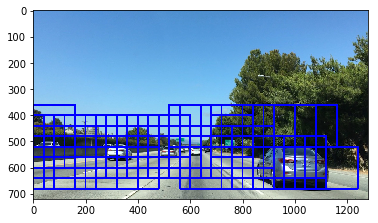

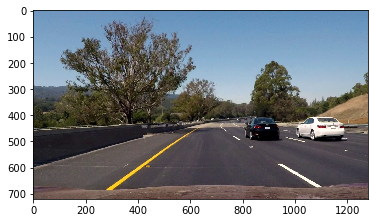

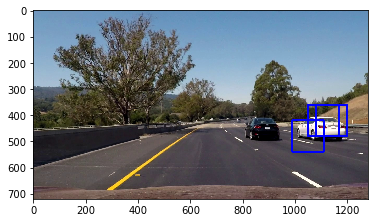

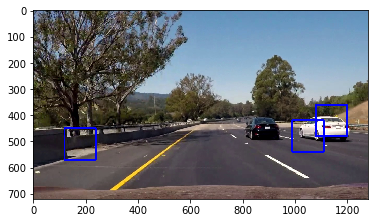

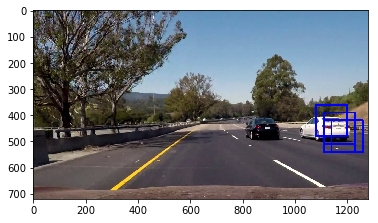

...

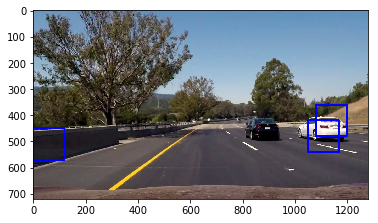

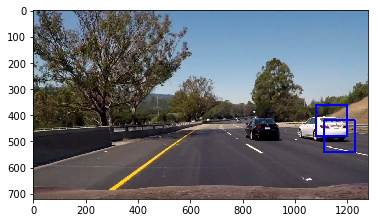

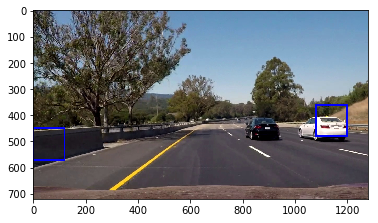

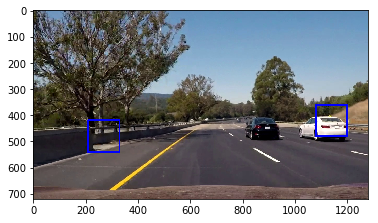

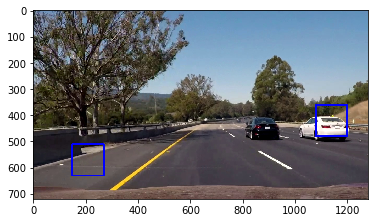

In [367]:
# Test Search Windows
y_start_stop = [360, 700]  # Min and max in y to search in slide_window()
image = cv2.imread('bbox-example-image.jpg')
draw_image = np.copy(image)

# Uncomment the following line if you extracted training
# data from .png images (scaled 0 to 1 by mpimg) and the
# image you are searching is a .jpg (scaled 0 to 255)
# image = image.astype(np.float32)/255

windows = slide_window(image, x_start_stop=[None, None], y_start_stop=y_start_stop,
                       xy_window=(160, 160), xy_overlap=(0.75, 0.75))

hot_windows = search_windows(image, windows, svc, X_scaler, color_space=colorspace,
                             spatial_size=spatial_size, hist_bins=hist_bins,
                             orient=orient, pix_per_cell=pix_per_cell,
                             cell_per_block=cell_per_block,
                             hog_channel=hog_channel, spatial_feat=use_spatial_feat,
                             hist_feat=use_hist_feat, hog_feat=use_hog_feat)

window_img = draw_boxes(draw_image, hot_windows, color=(255, 0, 0), thick=6)

plt.imshow(cv2.cvtColor(window_img, cv2.COLOR_BGR2RGB))
plt.show()

images = glob.glob('output_images/*.jpg')
for file in images:
    image = cv2.imread(file)
    draw_image = np.copy(image)
    windows = slide_window(image, x_start_stop=[None, None], y_start_stop=y_start_stop,
                       xy_window=(120, 120), xy_overlap=(0.75, 0.75))

    hot_windows = search_windows(image, windows, svc, X_scaler, color_space=colorspace,
                             spatial_size=spatial_size, hist_bins=hist_bins,
                             orient=orient, pix_per_cell=pix_per_cell,
                             cell_per_block=cell_per_block,
                             hog_channel=hog_channel, spatial_feat=use_spatial_feat,
                             hist_feat=use_hist_feat, hog_feat=use_hog_feat)

    window_img = draw_boxes(draw_image, hot_windows, color=(255, 0, 0), thick=6)

    plt.imshow(cv2.cvtColor(window_img, cv2.COLOR_BGR2RGB))
    plt.show()


### HOG Subsampling Window Search

***Sub Sampling HOG ***

 * Extract HOG features just once for the entire region of interest in each full image / video frame

In *Search_Windows* function, we extracted HOG features from each individual window as you searched across the image, but it turns out this is rather inefficient. To speed things up, extract HOG features just once for the entire region of interest (i.e. lower half of each frame of video) and subsample that array for each sliding window. To do this, apply 
```python
skimage.feature.hog()
```
with the flag feature_vec=False, like this:

```python
from skimage.feature import hog
orient = 9
pix_per_cell = 8
cell_per_block = 2
feature_array = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell), cells_per_block=(cell_per_block, cell_per_block), visualise=False, feature_vector=False)
```
The output feature_array will have a shape of (n_yblocks, n_xblocks, 2, 2, 9), where n_yblocks and n_xblocks are determined by the shape of your region of interest (i.e. how many blocks fit across and down your image in x and y).
So, for example, if you used cells_per_block=2 in extracting features from the 64x64 pixel training images, then you would want to extract subarrays of shape (7, 7, 2, 2, 9) from feature_array and then use np.ravel() to unroll the feature vector.

*** Value Range Difference for Different Library and Format***

The training dataset provided for this project ( vehicle and non-vehicle images) are in the *.png* format. Somewhat confusingly, *matplotlib image* will read these in on a scale of 0 to 1, but *cv2.imread()* will scale them from 0 to 255. Be sure if you are switching between *cv2.imread()* and *matplotlib image* for reading images that you scale them appropriately! Otherwise your feature vectors can get screwed up.

To add to the confusion, *matplotlib image* will read *.jpg* images in on a scale of 0 to 255 so if you are testing your pipeline on *.jpg* images remember to scale them accordingly. And if you take an image that is scaled from 0 to 1 and change color spaces using *cv2.cvtColor()* you'll get back an image scaled from 0 to 255. So just be sure to be consistent between your training data features and inference features!

*** Value Range In This Project ***
 - **Color Space is BGR** - Image value range is 0 to 255.   
 
    Since training data set is *.png* format, *cv2* read in range 0 to 255. 
    
 

In [471]:
# Define a single function that can extract features using hog sub-sampling and make predictions
#
# img format must be BGR with value range 0-255 (jpg or use MovieBy get_frame)
# 
def find_cars(img, ystart, ystop, 
              scale, svc, X_scaler, 
              orient, pix_per_cell, cell_per_block, 
              spatial_size, hist_bins, color_space,    
              cells_per_step = 2, # Instead of overlap, define how many cells to step
              spatial_feat=True,
              hist_feat=True,
              hog_feat=True,
              hog_channel='ALL',
              window = 64,
              vis = True,
              scale_normalize=False
             ):
    if vis:
        draw_img = np.copy(img)
    # data is jpg or use MoviePy get_frame, the format is RGB with value range 0-255.
    # need to scale to 0-1
    #
    if scale_normalize:
        img = img.astype(np.float32) / 255
    #
    # interest area
    img_tosearch = img[ystart:ystop, :, :]
    if color_space != 'BGR': # only convert with 
        ctrans_tosearch = convert_color(img_tosearch, conv='BGR2' + color_space)
    else:
        ctrans_tosearch = img_tosearch
    # equivalent to scale up car 64x64 to (64*scale) * (64*scale)
    if scale != 1:
        imshape = ctrans_tosearch.shape
        ctrans_tosearch = cv2.resize(ctrans_tosearch, (np.int(imshape[1] / scale), np.int(imshape[0] / scale)))

    ch1 = ctrans_tosearch[:, :, 0]
    ch2 = ctrans_tosearch[:, :, 1]
    ch3 = ctrans_tosearch[:, :, 2]

    # Define blocks and steps as above
    nxblocks = (ch1.shape[1] // pix_per_cell) - 1
    nyblocks = (ch1.shape[0] // pix_per_cell) - 1
    
    nfeat_per_block = orient * cell_per_block ** 2
    # 64 was the orginal sampling rate, with 8 cells and 8 pix per cell
    #window = 64
    nblocks_per_window = (window // pix_per_cell) - 1
    nxsteps = (nxblocks - nblocks_per_window) // cells_per_step
    nysteps = (nyblocks - nblocks_per_window) // cells_per_step

    # Compute individual channel HOG features for the entire image
    hog1 = get_hog_features(ch1, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog2 = get_hog_features(ch2, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog3 = get_hog_features(ch3, orient, pix_per_cell, cell_per_block, feature_vec=False)
    window_list = []
    for xb in range(nxsteps):
        for yb in range(nysteps):
            ypos = yb * cells_per_step
            xpos = xb * cells_per_step
            # Extract HOG for this patch
            hog_feat1 = hog1[ypos:ypos + nblocks_per_window, xpos:xpos + nblocks_per_window].ravel()
            hog_feat2 = hog2[ypos:ypos + nblocks_per_window, xpos:xpos + nblocks_per_window].ravel()
            hog_feat3 = hog3[ypos:ypos + nblocks_per_window, xpos:xpos + nblocks_per_window].ravel()
            if hog_channel == 'ALL':
                hog_features = []
                for channel_hog in [hog_feat1, hog_feat2, hog_feat3]:
                    hog_features.append( channel_hog )
                hog_features = np.ravel(hog_features)
            else:
                hog_features = [hog_feat1, hog_feat2, hog_feat3][hog_channel]

            xleft = xpos * pix_per_cell
            ytop = ypos * pix_per_cell
            
            sub_features = []
            # Extract the image patch
            if spatial_feat or hist_feat:
                subimg = cv2.resize(ctrans_tosearch[ytop:ytop + window, xleft:xleft + window], (64, 64))

                # Get color features
                if spatial_feat:
                    spatial_features = bin_spatial(subimg, size=spatial_size)
                    sub_features.append(spatial_features)
                if hist_feat:
                    hist_features = color_hist(subimg, nbins=hist_bins)
                    sub_features.append(hist_features)
            if hog_feat:
                sub_features.append(hog_features)
                
            sub_features = np.concatenate(sub_features)
            # Scale features and make a prediction
            test_features = X_scaler.transform(
                sub_features.reshape(1, -1))
            
            test_prediction = svc.predict(test_features)

            if test_prediction == 1:
                
                test_score = svc.decision_function(test_features)
                xbox_left = np.int(xleft * scale)
                ytop_draw = np.int(ytop * scale)
                win_draw = np.int(window * scale)
                startx = xbox_left
                starty = ytop_draw + ystart
                endx = xbox_left + win_draw
                endy = ytop_draw + win_draw + ystart
                ((startx, starty), (endx, endy))                
                window_list.append(((startx, starty), (endx, endy), test_score))
                if vis:
                    cv2.rectangle(draw_img, (startx, starty), (endx, endy), (0, 0, 255), 6)

    if vis:
        return window_list,draw_img
    else:
        return window_list

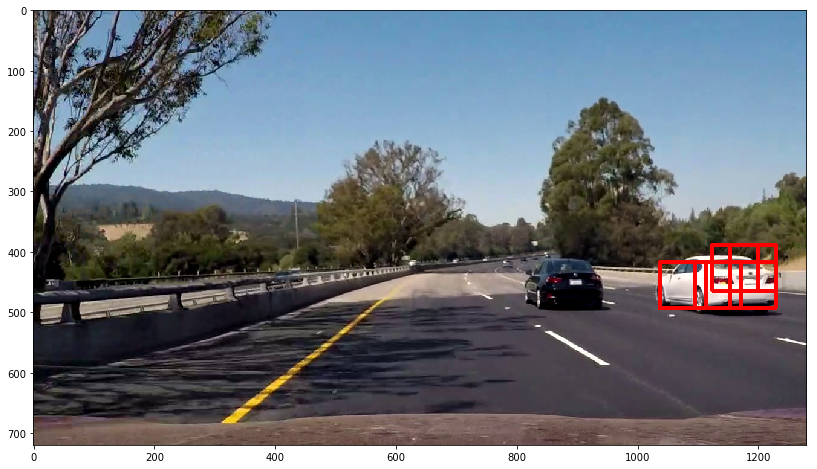

In [368]:
# Test find_car
ystart = 360
ystop = 700
scale = 1.2

#img = cv2.imread('bbox-example-image.jpg')
img = cv2.imread('output_images/frame20.jpg')

bbox_list, out_img = find_cars(img, ystart, ystop, 
                                 scale, svc, X_scaler, orient, pix_per_cell, cell_per_block, 
                                 spatial_size, hist_bins, 
                                 spatial_feat=use_spatial_feat,
                                 hist_feat=use_spatial_feat,
                                 hog_feat=use_hog_feat,
                                 hog_channel=hog_channel,
                                 color_space=colorspace,
                                 vis=True,
                                 scale_normalize=False)
plt.figure(figsize=(16,8))
plt.imshow(cv2.cvtColor(out_img, cv2.COLOR_BGR2RGB))
plt.show()


### Multiple Scan for Different Scale

10 16 2
0.34 Seconds to Detect Cars


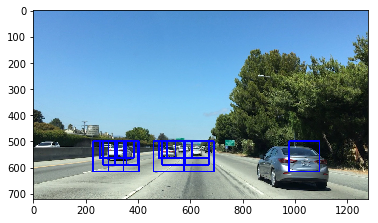

In [472]:
scan_passes = [(2.5, 500, 720), (1.8, 500, 680),(1.4, 500, 640), (1, 500, 600)]
img = cv2.imread('bbox-example-image.jpg')
t=time.time()
bbox_list = []
print(orient, pix_per_cell, cell_per_block)
for scan_pass in scan_passes:
    bboxes = find_cars(img, scan_pass[1], scan_pass[2], 
                                 scan_pass[0], svc, X_scaler, orient, pix_per_cell, cell_per_block, 
                                 spatial_size, hist_bins, 
                                 spatial_feat=use_spatial_feat,
                                 hist_feat=use_spatial_feat,
                                 hog_feat=use_hog_feat,
                                 hog_channel=hog_channel,
                                 color_space=colorspace,
                                 vis=False,
                                 scale_normalize=False)
    bbox_list.extend(bboxes)

out_img = draw_boxes(img, bbox_list, color=(255, 0, 0))    
t2 = time.time()
print(round(t2-t, 5), 'Seconds to Detect Cars')
plt.imshow(cv2.cvtColor(out_img, cv2.COLOR_BGR2RGB))
plt.show()
with open( "bbox_pickle.p", "wb" ) as handle:
    pickle.dump( bbox_list, handle)
    

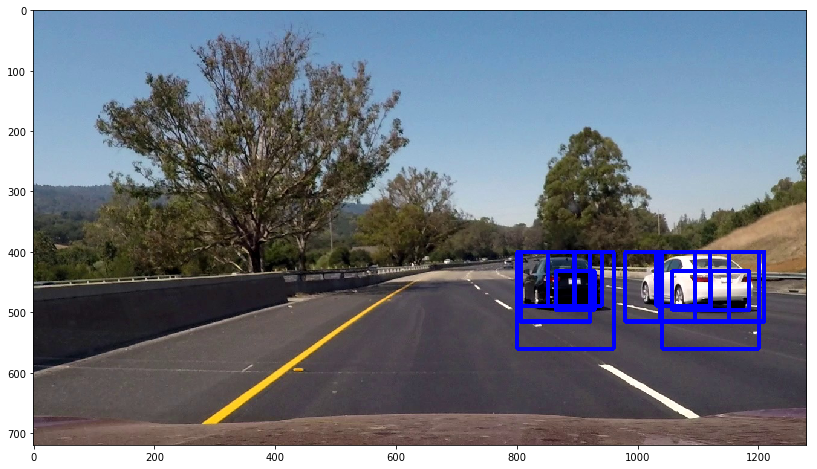

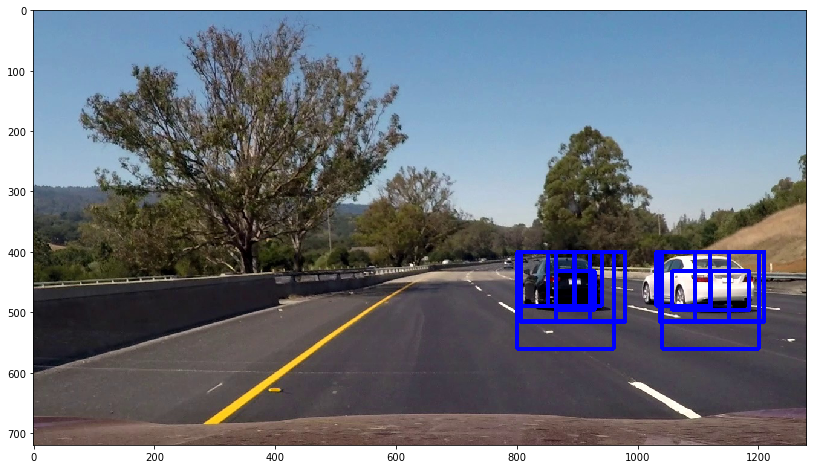

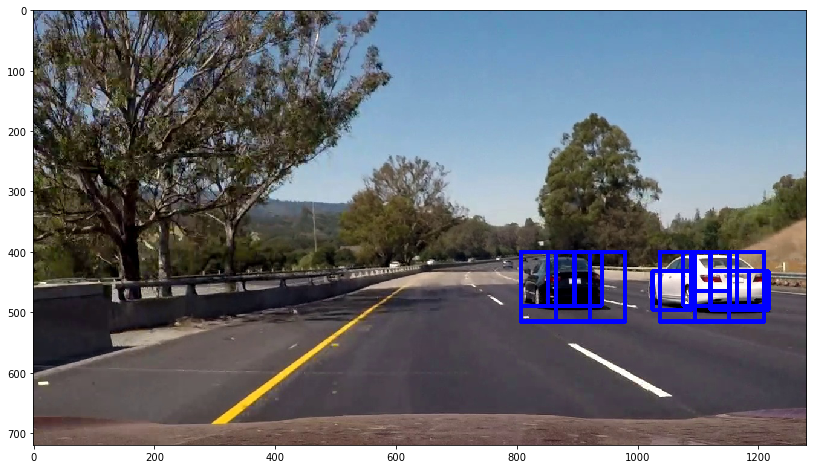

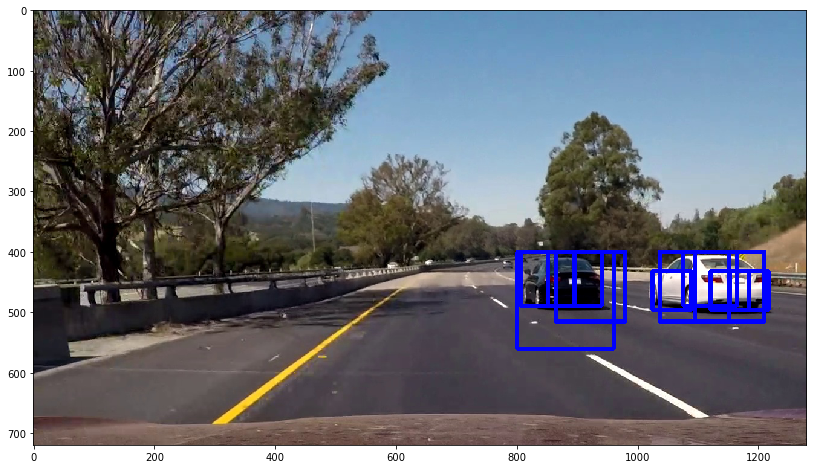

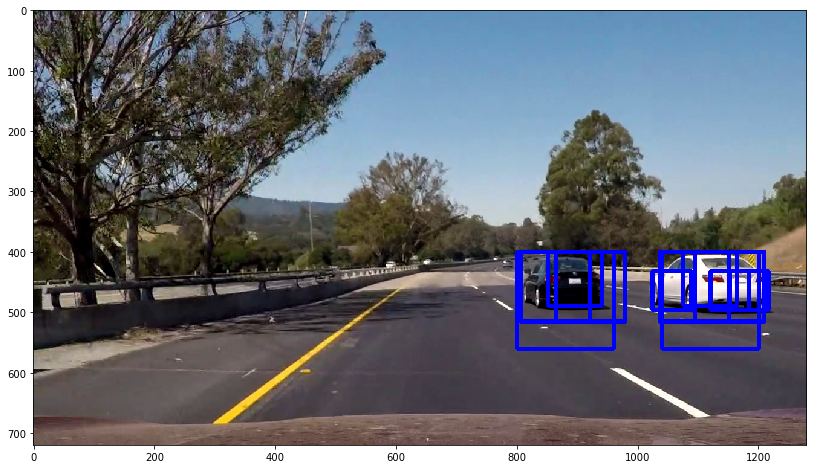

...

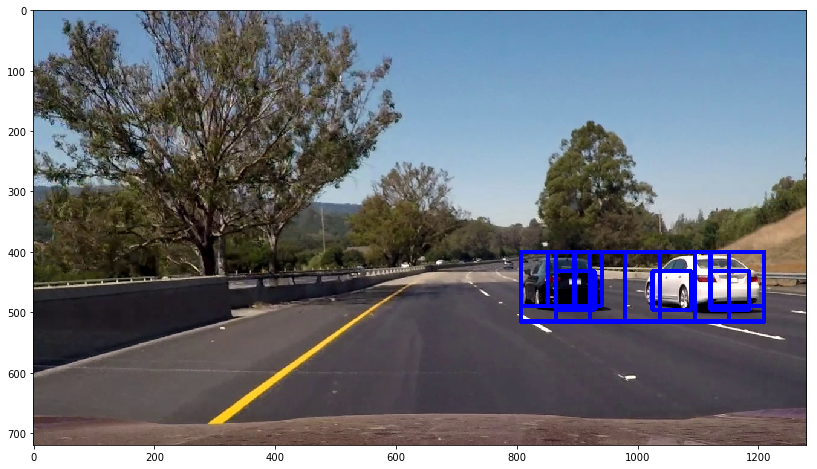

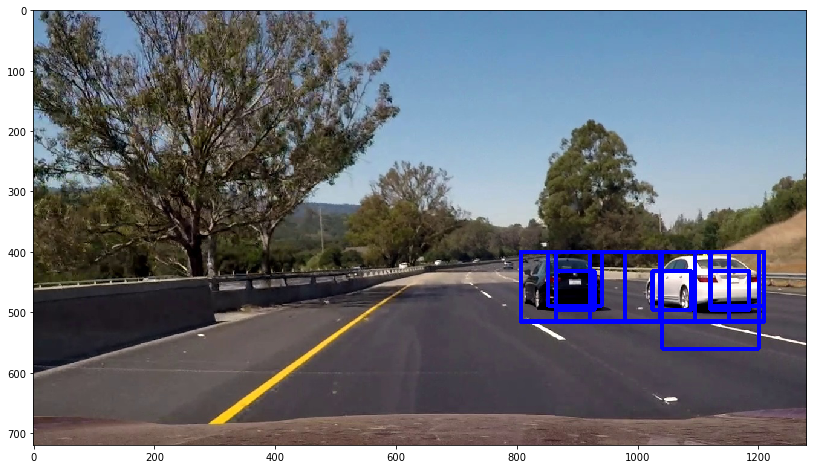

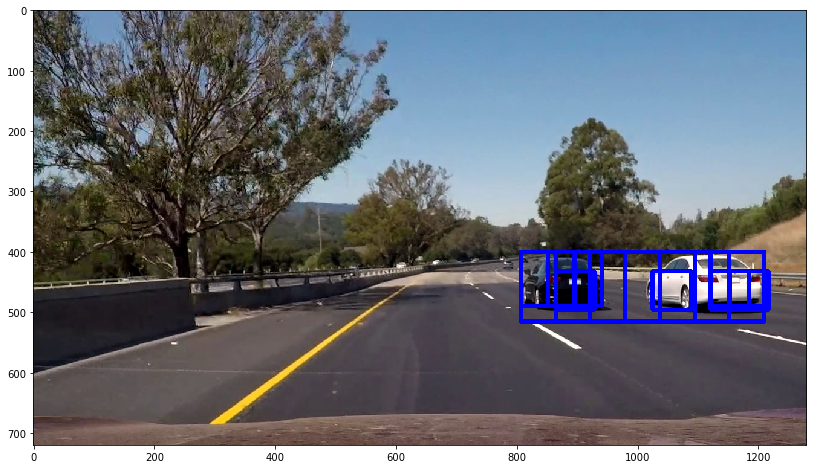

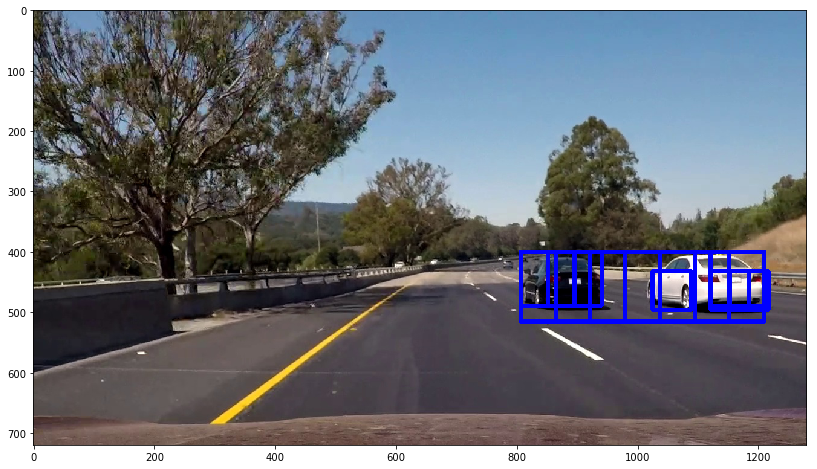

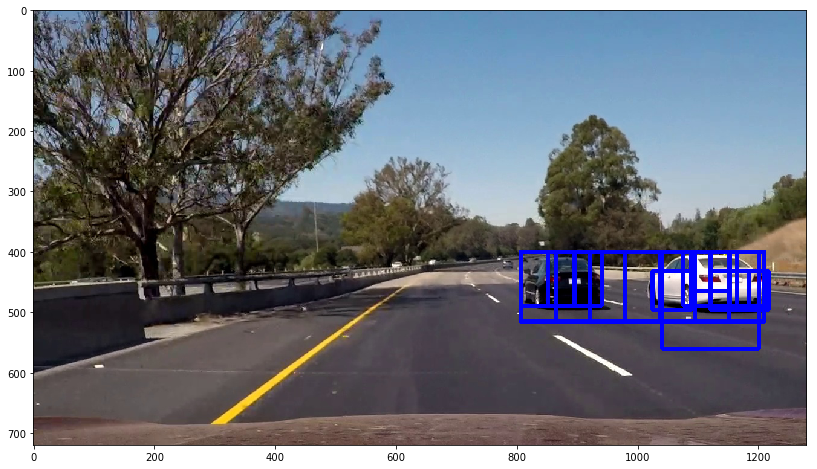

In [470]:
# Test Multi Scan in to test images and test_video output images

scan_passes = [(2.5, 400, 720), (1.8, 400, 680),(1.4, 400, 640), (1, 400, 600)]
#images = glob.glob('test_images/*.jpg')
images = glob.glob('output_images/*.jpg')
for file in images:
    img = cv2.imread(file)
    draw_image = np.copy(img)
    bbox_list = []
    for scan_pass in scan_passes:
        bboxes = find_cars(img, scan_pass[1], scan_pass[2], 
                                     scan_pass[0], svc, X_scaler, orient, pix_per_cell, cell_per_block, 
                                     spatial_size, hist_bins, 
                                     spatial_feat=use_spatial_feat,
                                     hist_feat=use_spatial_feat,
                                     hog_feat=use_hog_feat,
                                     hog_channel=hog_channel,
                                     color_space=colorspace,
                                     vis=False,
                                     scale_normalize=False)
        bbox_list.extend(bboxes)
    draw_image = draw_boxes(draw_image, bbox_list, color=(255, 0, 0))
    plt.figure(figsize=(16,8))
    plt.imshow(cv2.cvtColor(draw_image, cv2.COLOR_BGR2RGB))
    plt.show()    

### Heatmap and Threshold

In [260]:
from scipy.ndimage.measurements import label

def add_heat(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1

    # Return updated heatmap
    return heatmap# Iterate through list of bboxes
    
def apply_threshold(heatmap, threshold):
    # Zero out pixels below the threshold
    heatmap[heatmap <= threshold] = 0
    # Return thresholded map
    return heatmap

def draw_labeled_bboxes(img, labels, color=(0, 0, 255)):
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        # Draw the box on the image
        cv2.rectangle(img, bbox[0], bbox[1], color, 6)
    # Return the image
    return img


### Test Heatmap for Threshold False Positive and Bounding Box

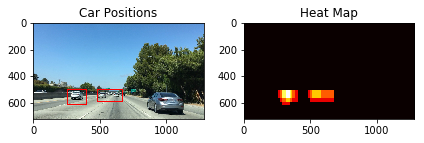

In [474]:
#
# Test Heatmap for false positive and bounding box
#
box_list = pickle.load(open("bbox_pickle.p", "rb"))

# Read in image similar to one shown above
image = cv2.imread('bbox-example-image.jpg')
heat = np.zeros_like(image[:, :, 0]).astype(np.float)

# Add heat to each box in box list
heat = add_heat(heat, box_list)

# Apply threshold to help remove false positives
heat = apply_threshold(heat, 1)

# Visualize the heatmap when displaying
heatmap = np.clip(heat, 0, 255)

# Find final boxes from heatmap using label function
labels = label(heatmap)
draw_img = draw_labeled_bboxes(np.copy(image), labels)

fig = plt.figure()
plt.subplot(121)
plt.imshow(cv2.cvtColor(draw_img, cv2.COLOR_BGR2RGB))
plt.title('Car Positions')
plt.subplot(122)
#plt.imshow(heatmap, cmap='hot')
# try use cmap to get RGB 
cmap = plt.get_cmap('hot')
# data range is 0 to 1.0 for cmap
plt.imshow(cmap(heatmap / np.max(heatmap)))

plt.title('Heat Map')
fig.tight_layout()
plt.show()

#### Tips and Tricks for the Project 


*** Value Range Difference for Different Library and Format***


The training dataset provided for this project ( vehicle and non-vehicle images) are in the .png format. Somewhat confusingly, matplotlib image will read these in on a scale of 0 to 1, but cv2.imread() will scale them from 0 to 255. Be sure if you are switching between cv2.imread() and matplotlib image for reading images that you scale them appropriately! Otherwise your feature vectors can get screwed up.

To add to the confusion, matplotlib image will read .jpg images in on a scale of 0 to 255 so if you are testing your pipeline on .jpg images remember to scale them accordingly. And if you take an image that is scaled from 0 to 1 and change color spaces using cv2.cvtColor() you'll get back an image scaled from 0 to 255. So just be sure to be consistent between your training data features and inference features!

*** Normalize Training Data ***

Be sure to normalize your training data
Use sklearn.preprocessing.StandardScaler() to normalize your feature vectors for training your classifier as described in this lesson. Then apply the same scaling to each of the feature vectors you extract from windows in your test images.


### SVC Training with Vehicle and Non-Vehicle Data

In [146]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import cv2
import glob
import time
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
from skimage.feature import hog
# NOTE: the next import is only valid for scikit-learn version <= 0.17
# for scikit-learn >= 0.18 use:
from sklearn.model_selection import train_test_split
# from sklearn.cross_validation import train_test_split
import pickle
from sklearn.utils import shuffle

In [624]:
cars = glob.glob('vehicles/*/*.png')
notcars = glob.glob('non-vehicles/*/*.png')

#cars = shuffle( cars, random_state=0)
#notcars = shuffle( notcars, random_state=0)
print(len(cars), len(notcars))

8792 8968


### Sequential Image Problem

Many images in the data set are extract from time serial images that are very similiar.  If I use all the car data set, the test 
accuracy is almost 99.95%.  It looks too good for training a classifier.  But if I just shuffle and randomly choose samples, the accuracy is much lower that.  To correct this problem, I need to choose what images used in car data set. 

*** Compare Image Histogram for Similarity ***


HISTCMP_CORREL


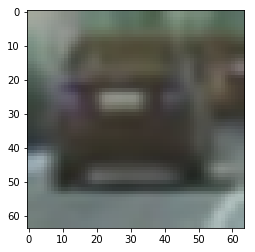

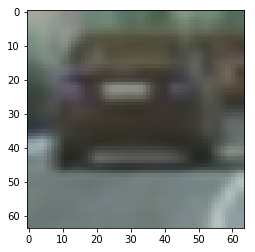

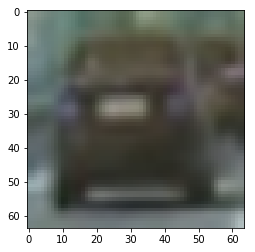

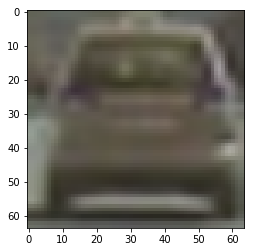

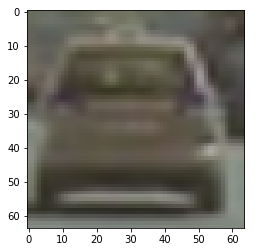

0.9868086459723857
0.9827595892960981
0.8709104318080976
0.8815859244122878


In [622]:
import cv2
for option in cv2.__dict__:
    if 'CORREL' in option:
        print (option)
        
sample_no=5
test_cars = cars[0:sample_no]
hist_index = {}

for filename in test_cars:
    image = cv2.imread(filename)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)     
    hist = cv2.calcHist([image], [0, 1, 2], None, [8, 8, 8],
        [0, 256, 0, 256, 0, 256])
    dst = np.copy(hist)
    hist = cv2.normalize(hist, dst).flatten()
    hist_index[filename]=hist
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.show() 

hist0 = hist_index[test_cars[0]]

for filename in test_cars[1:]:
    hist = hist_index[filename]
    d = cv2.compareHist(hist0, hist, method=cv2.HISTCMP_CORREL )    
    print(d)
        

The first 3 pictures are very similar.  The histogram correlation score is 98%. We can use a threshold value to filter out consecutive similar pictures in data set.

*** Filter out Cars Data Set Using Histogram Comparison ***

In [625]:
def cal_hist(file):
    image = cv2.imread(filename)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)     
    hist = cv2.calcHist([image], [0, 1, 2], None, [8, 8, 8],
        [0, 256, 0, 256, 0, 256])
    dst = np.copy(hist)
    hist = cv2.normalize(hist, dst).flatten()
    return hist

#
# filter out similar images in cars data set
# 
threshold_score = 0.96
hist0 = cal_hist(cars[0])
newcars = []

for filename in cars[1:]:
    hist = cal_hist(filename)
    d = cv2.compareHist(hist0, hist, method=cv2.HISTCMP_CORREL )    
    if d < threshold_score:
        hist0 = hist
        newcars.append(filename)
        
cars = newcars        

notcars = shuffle(notcars)
notcars = notcars[:len(cars)]
print('New data set length = ', len(cars), len(notcars))

New data set length =  6606 6606


In [427]:
# Reduce the sample size because HOG features are slow to compute

###  Tweak these parameters and see how the results change.
colorspace = 'YCrCb' # Can be BGR, HSV, LUV, HLS, YUV, YCrCb
orient = 9
pix_per_cell = 8
cell_per_block = 2
hog_channel = "ALL" # Can be 0, 1, 2, or "ALL"

spatial_size = (32, 32)
hist_bins = 32
use_spatial_feat=True
use_hist_feat=True
use_hog_feat=True

t=time.time()
car_features = extract_features(cars, 
                        spatial_size=spatial_size,
                        hist_bins=hist_bins,
                        color_space=colorspace, orient=orient,
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial_feat=use_spatial_feat, hist_feat=use_hist_feat, hog_feat=use_hog_feat)
                        
notcar_features = extract_features(notcars, 
                        spatial_size=spatial_size,
                        hist_bins=hist_bins,
                        color_space=colorspace, orient=orient,
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial_feat=use_spatial_feat, hist_feat=use_hist_feat, hog_feat=use_hog_feat)
                        
t2 = time.time()
print(round(t2-t, 2), 'Seconds to extract HOG features...')
# Create an array stack of feature vectors
X = np.vstack((car_features, notcar_features)).astype(np.float64)
# Fit a per-column scaler
X_scaler = StandardScaler().fit(X)
# Apply the scaler to X
scaled_X = X_scaler.transform(X)

# Define the labels vector
y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))


# Split up data into randomized training and test sets
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(
    scaled_X, y, test_size=0.2, random_state=rand_state)

print('Using:',orient,'orientations',pix_per_cell,
    'pixels per cell and', cell_per_block,'cells per block')
print('Feature vector length:', len(X_train[0]))

79.48 Seconds to extract HOG features...
Using: 9 orientations 8 pixels per cell and 2 cells per block
Feature vector length: 8460


*** Tune LinearSVC Parameters ***

In [458]:
from sklearn.model_selection import GridSearchCV
t=time.time()
parameters = {'C':[0.01, 0.05, 0.1, 0.5, 1]} 
svr = LinearSVC() 
clf = GridSearchCV(svr, parameters) 
clf.fit(X_train, y_train) 
# The fit function now tries all the parameter combinations, 
# and returns a fitted classifier that's automatically tuned to the optimal parameter combination. 
t2 = time.time()
print(round(t2-t, 2), 'Seconds to tune LinearSVC...')
print ( 'Best parameter:', clf.best_params_)

64.66 Seconds to tune LinearSVC...
Best parameter: {'C': 0.01}


In [461]:
# Use a linear SVC
svc = LinearSVC(C=0.1)
# Check the training time for the SVC
t=time.time()
svc.fit(X_train, y_train)
t2 = time.time()
print(round(t2-t, 2), 'Seconds to train SVC...')
# Check the score of the SVC
print('Test Accuracy of SVC = ', round(svc.score(X_test, y_test), 8))
# Check the prediction time for a single sample
t=time.time()
n_predict = 10
print('My SVC predicts: ', svc.predict(X_test[0:n_predict]))
print('For these',n_predict, 'labels: ', y_test[0:n_predict])
t2 = time.time()
print(round(t2-t, 5), 'Seconds to predict', n_predict,'labels with SVC')

3.51 Seconds to train SVC...
Test Accuracy of SVC =  0.99583806
My SVC predicts:  [ 0.  1.  1.  1.  0.  0.  1.  1.  0.  1.]
For these 10 labels:  [ 0.  1.  1.  1.  0.  0.  1.  1.  0.  1.]
0.017 Seconds to predict 10 labels with SVC


*** Discussion of Parameter C Choices ***

The accuracy is pretty much the same over a range of [0.1 to 10].  If we search lower values and only when C is lower than 0.001 the test accuracy start to decline.  
If C is small enough, the decline of test accuracy means under fit.  If C is very large, the test accuracy might be good but easy to overfit. 

I just choose a C=0.1 value not extreme small, but good enough but remain in high accuracy.

*** Parameters Tuning for HOG orient, pix_per_cell ***

Although our test accuracy looks very good now at 0.99946.  I'd like to try to tune other parameters 
that have better result shown in discussion forum.  
The first is HOG orient value.  I'd like to try it over a range of values.


In [457]:
orient_values = [8, 9, 10, 11, 12]
pix_per_cell_values = [8, 12, 16]
test_accuracy_values = np.array([]).reshape(0,len(pix_per_cell_values))
for orient in orient_values:
    acc1 = []
    for pix_per_cell in pix_per_cell_values:
        t=time.time()
        car_features = extract_features(cars, 
                                spatial_size=spatial_size,
                                hist_bins=hist_bins,
                                color_space=colorspace, orient=orient,
                                pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                                spatial_feat=use_spatial_feat, hist_feat=use_hist_feat, hog_feat=use_hog_feat)

        notcar_features = extract_features(notcars, 
                                spatial_size=spatial_size,
                                hist_bins=hist_bins,
                                color_space=colorspace, orient=orient,
                                pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                                spatial_feat=use_spatial_feat, hist_feat=use_hist_feat, hog_feat=use_hog_feat)

        t2 = time.time()
        print(round(t2-t, 2), 'Seconds to extract HOG features...')
        # Create an array stack of feature vectors
        X = np.vstack((car_features, notcar_features)).astype(np.float64)
        # Fit a per-column scaler
        X_scaler = StandardScaler().fit(X)
        # Apply the scaler to X
        scaled_X = X_scaler.transform(X)

        # Define the labels vector
        y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))


        # Split up data into randomized training and test sets
        #rand_state = np.random.randint(0, 100)
        rand_state = 33
        X_train, X_test, y_train, y_test = train_test_split(
            scaled_X, y, test_size=0.2, random_state=rand_state)

        print('Using:',orient,'orientations',pix_per_cell,
            'pixels per cell and', cell_per_block,'cells per block')
        print('Feature vector length:', len(X_train[0]))   
        # Use a linear SVC
        svc = LinearSVC(C=0.1)
        # Check the training time for the SVC
        t=time.time()
        svc.fit(X_train, y_train)
        t2 = time.time()
        test_accuracy = svc.score(X_test, y_test)
        print(round(t2-t, 2), 'Seconds to train SVC...')
        # Check the score of the SVC
        print('Test Accuracy of SVC = ', round(test_accuracy, 8))
        # Check the prediction time for a single sample
        t=time.time()
        acc1.append(test_accuracy)
        save_svc()
    test_accuracy_values = np.concatenate((test_accuracy_values, [acc1]),axis=0)
print('Test Accuracy of SVC = ')
print(test_accuracy_values)

74.35 Seconds to extract HOG features...
Using: 8 orientations 8 pixels per cell and 2 cells per block
Feature vector length: 7872
14.65 Seconds to train SVC...
Test Accuracy of SVC =  0.99356792
65.13 Seconds to extract HOG features...
Using: 8 orientations 12 pixels per cell and 2 cells per block
Feature vector length: 4704
8.45 Seconds to train SVC...
Test Accuracy of SVC =  0.99167613
73.55 Seconds to extract HOG features...
Using: 8 orientations 16 pixels per cell and 2 cells per block
Feature vector length: 4032
4.03 Seconds to train SVC...
Test Accuracy of SVC =  0.99394627
72.52 Seconds to extract HOG features...
Using: 9 orientations 8 pixels per cell and 2 cells per block
Feature vector length: 8460
16.55 Seconds to train SVC...
Test Accuracy of SVC =  0.99583806
61.91 Seconds to extract HOG features...
Using: 9 orientations 12 pixels per cell and 2 cells per block
Feature vector length: 4896
9.12 Seconds to train SVC...
Test Accuracy of SVC =  0.99205448
57.45 Seconds to ext

*** orient and pix_per_cell Choices ***

Shorter feature vector length means faster computation.  

 * Test Accuracy >= 0.9968, the shortest feature vector length is 4248
```python 
orient=10
pix_per_cell=16
```


In [626]:

# train with better parameters & 
# save the SVC, Xcaler, ... parameters
orient=10
pix_per_cell=16
colorspace='YCrCb'

t=time.time()
car_features = extract_features(cars, 
                        spatial_size=spatial_size,
                        hist_bins=hist_bins,
                        color_space=colorspace, orient=orient,
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial_feat=use_spatial_feat, hist_feat=use_hist_feat, hog_feat=use_hog_feat)
                        
notcar_features = extract_features(notcars, 
                        spatial_size=spatial_size,
                        hist_bins=hist_bins,
                        color_space=colorspace, orient=orient,
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                        spatial_feat=use_spatial_feat, hist_feat=use_hist_feat, hog_feat=use_hog_feat)
                        
t2 = time.time()
print(round(t2-t, 2), 'Seconds to extract HOG features...')
# Create an array stack of feature vectors
X = np.vstack((car_features, notcar_features)).astype(np.float64)
# Fit a per-column scaler
X_scaler = StandardScaler().fit(X)
# Apply the scaler to X
scaled_X = X_scaler.transform(X)

# Define the labels vector
y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))


# Split up data into randomized training and test sets
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(
    scaled_X, y, test_size=0.2, random_state=rand_state)

print('Using:',orient,'orientations',pix_per_cell,
    'pixels per cell and', cell_per_block,'cells per block')
print('Feature vector length:', len(X_train[0]))
# Use a linear SVC
svc = LinearSVC(C=0.1)
# Check the training time for the SVC
t=time.time()
svc.fit(X_train, y_train)
t2 = time.time()
print(round(t2-t, 2), 'Seconds to train SVC...')
print('Test Accuracy of SVC = ', round(svc.score(X_test, y_test), 8))
# Check the prediction time for a single sample
t=time.time()
n_predict = 10
print('My SVC predicts: ', svc.predict(X_test[0:n_predict]))
print('For these',n_predict, 'labels: ', y_test[0:n_predict])
t2 = time.time()
print(round(t2-t, 5), 'Seconds to predict', n_predict,'labels with SVC')

80.12 Seconds to extract HOG features...
Using: 10 orientations 16 pixels per cell and 2 cells per block
Feature vector length: 4248
6.68 Seconds to train SVC...
Test Accuracy of SVC =  0.99356792
My SVC predicts:  [ 1.  0.  0.  0.  1.  0.  1.  0.  1.  1.]
For these 10 labels:  [ 1.  0.  0.  0.  1.  0.  1.  0.  1.  1.]
0.017 Seconds to predict 10 labels with SVC


In [456]:
def save_svc():
    dict_pickle = {
        "svc": svc,
        "scaler": X_scaler,
        "colorspace":colorspace,
        "orient": orient,
        "pix_per_cell": pix_per_cell,
        "cell_per_block":cell_per_block,
        "hog_channel":hog_channel,
        "spatial_size": spatial_size,
        "hist_bins": hist_bins,
        "use_spatial_feat":use_spatial_feat,
        "use_hist_feat":use_hist_feat,
        "use_hog_feat":use_hog_feat,  
        "feature_vector_length": len(X_train[0]),
        "accuracy": svc.score(X_test, y_test),
        
    }
    filename = 'svc_project_pickle_{0}_{1}_{2}.p'.format(colorspace, orient, pix_per_cell)
    with open( filename, "wb" ) as handle:
        pickle.dump( dict_pickle, handle)

### Pipeline Function 

In [462]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import pickle
import cv2

# read back project parameters
dist_pickle = pickle.load(open("svc_project_pickle_YCrCb_10_16.p", "rb"))
svc = dist_pickle["svc"]
X_scaler = dist_pickle["scaler"]
colorspace = dist_pickle["colorspace"]
orient = dist_pickle["orient"]
pix_per_cell = dist_pickle["pix_per_cell"]
cell_per_block = dist_pickle["cell_per_block"]
hog_channel = dist_pickle["hog_channel"]
spatial_size = dist_pickle["spatial_size"]
hist_bins = dist_pickle["hist_bins"]
use_spatial_feat = dist_pickle["use_spatial_feat"]
use_hist_feat = dist_pickle["use_hist_feat"]
use_hog_feat = dist_pickle["use_hog_feat"]

In [463]:
use_pipeline_vis=True
use_heatmap_track=False
use_heat = True
heat = None # initialize heatmap


In [500]:
def process_image(img, vis=use_pipeline_vis, heat_track=use_heatmap_track, use_heat=use_heat, heatmap_filter=1):
    # convert to BGR first, 
    draw_img = np.copy(img)
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    bbox_list = []
    for scan_pass in scan_passes:
        bboxes = find_cars(img, scan_pass[1], scan_pass[2], 
                                 scan_pass[0], svc, X_scaler, orient, pix_per_cell, cell_per_block, 
                                 spatial_size, hist_bins, 
                                 spatial_feat=use_spatial_feat,
                                 hist_feat=use_spatial_feat,
                                 hog_feat=use_hog_feat,
                                 hog_channel=hog_channel,
                                 cells_per_step = 1,
                                 color_space=colorspace,
                                 vis=False,
                                 scale_normalize=False)
        bbox_list.extend(bboxes)
    if use_heat:
        # use heatmap for tracking
        if heat_track:
            if heat is None:
                heat = np.zeros_like(img[:, :, 0]).astype(np.float)
            else:
            # fade 
                pass
        else:
            heat = np.zeros_like(img[:, :, 0]).astype(np.float)

        # Add heat to each box in box list
        heat = add_heat(heat, bbox_list)

        # Apply threshold to help remove false positives
        heat = apply_threshold(heat, heatmap_filter)

        # Visualize the heatmap when displaying
        heatmap = np.clip(heat, 0, 255)

        # Find final boxes from heatmap using label function
        labels = label(heatmap)
        draw_img = draw_labeled_bboxes(draw_img, labels)
    else:
        draw_img = draw_boxes(draw_img, bbox_list, color=(0, 0, 255))
    return draw_img

In [230]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

### Test Video

In [303]:
# grab test frames for test
# 
count = 0
vidcap = cv2.VideoCapture('test_video.mp4')
success,image = vidcap.read()
while success:
    success, image = vidcap.read()
    cv2.imwrite("output_images/frame%d.jpg" % count, image)     # save frame as JPEG file\n",
    count += 1
print ('Read {0}frames: ', count)

Read {0}frames:  31


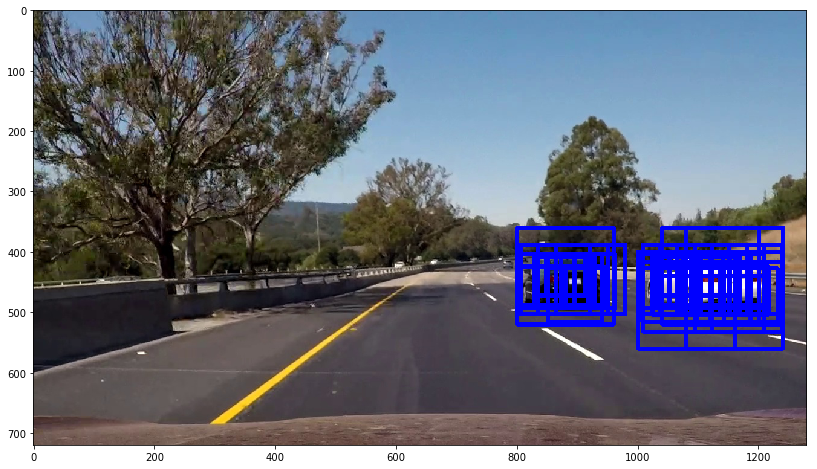

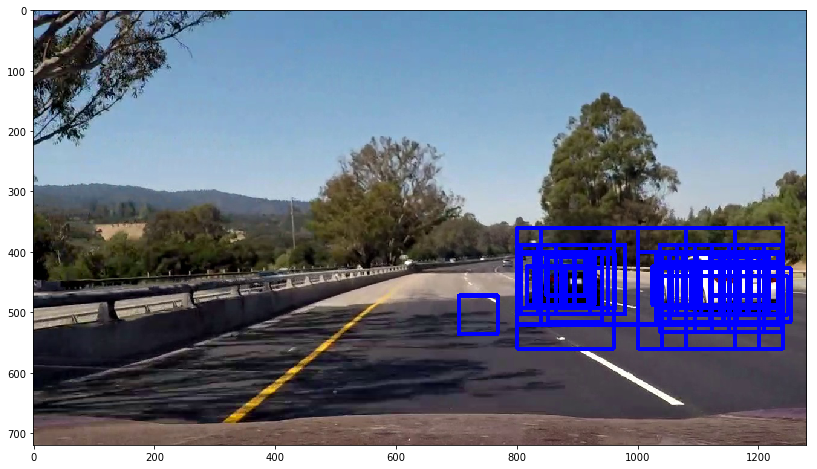

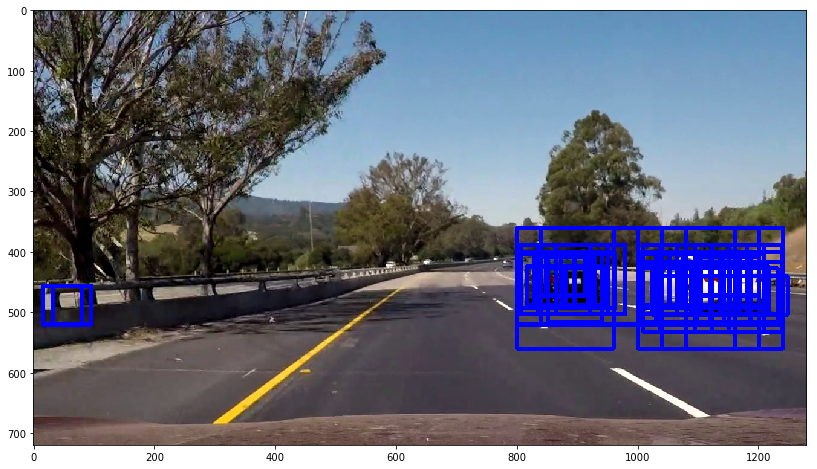

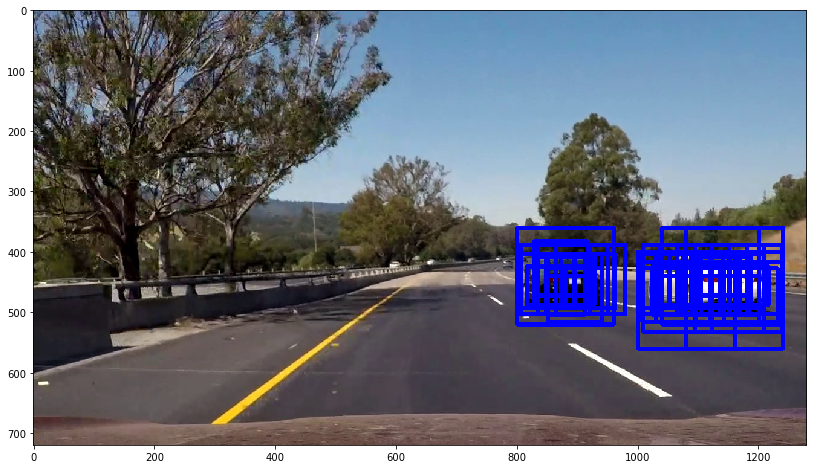

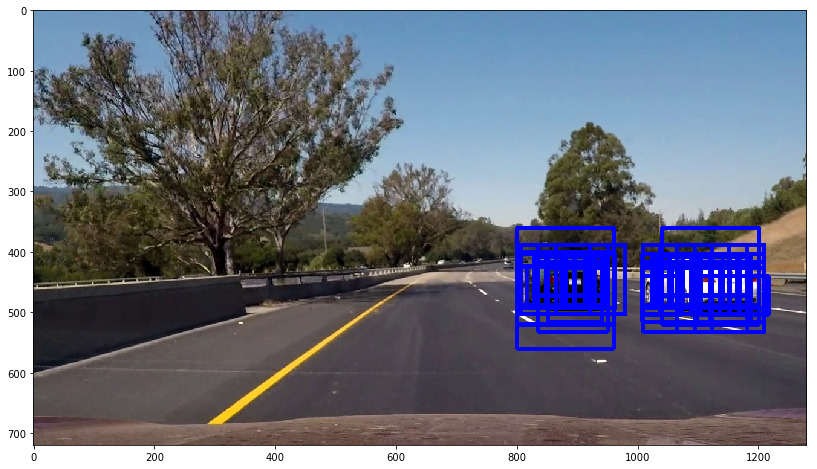

...

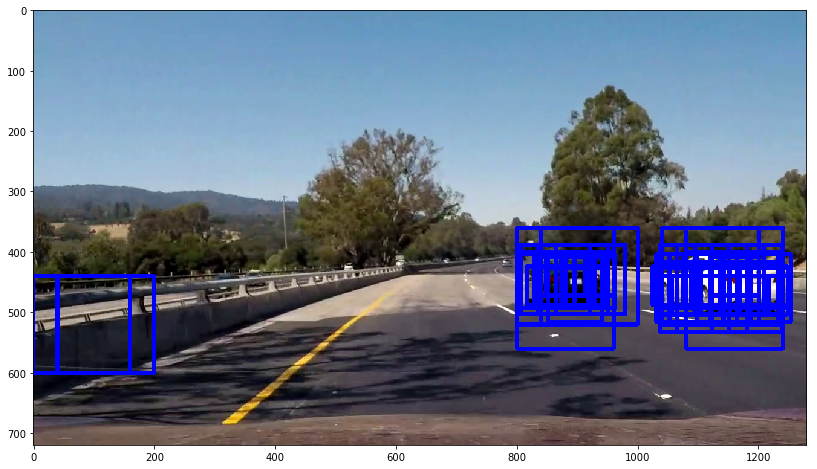

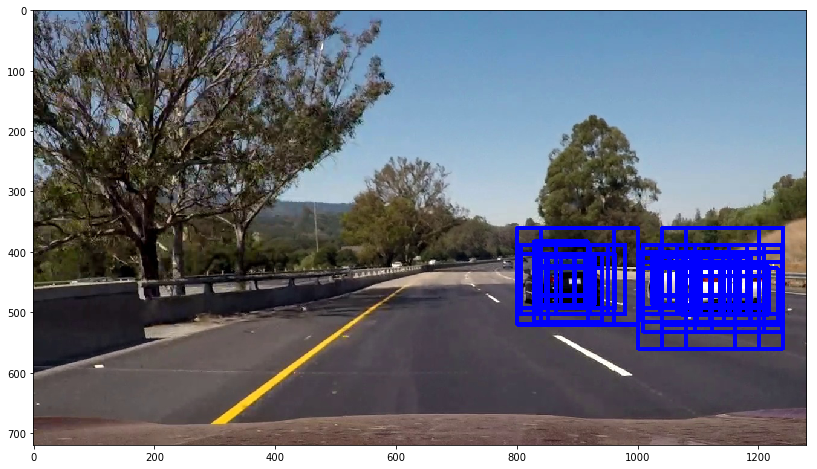

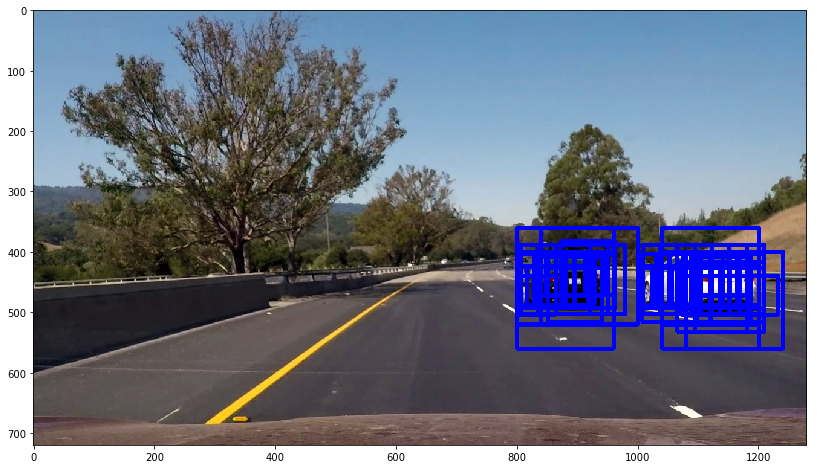

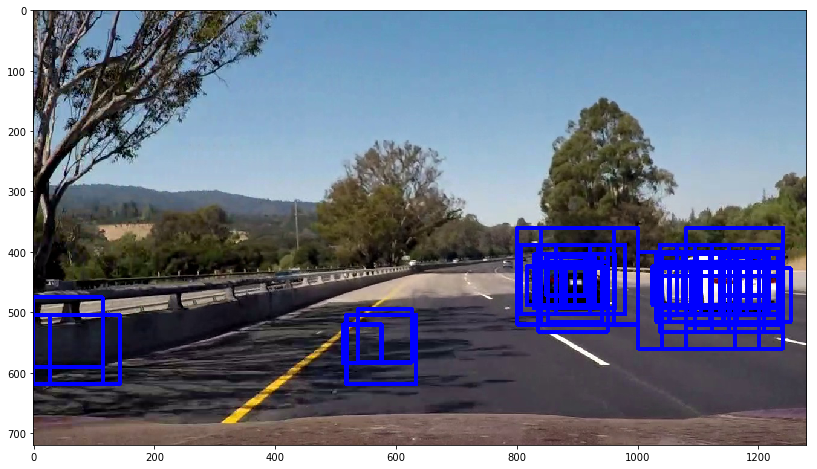

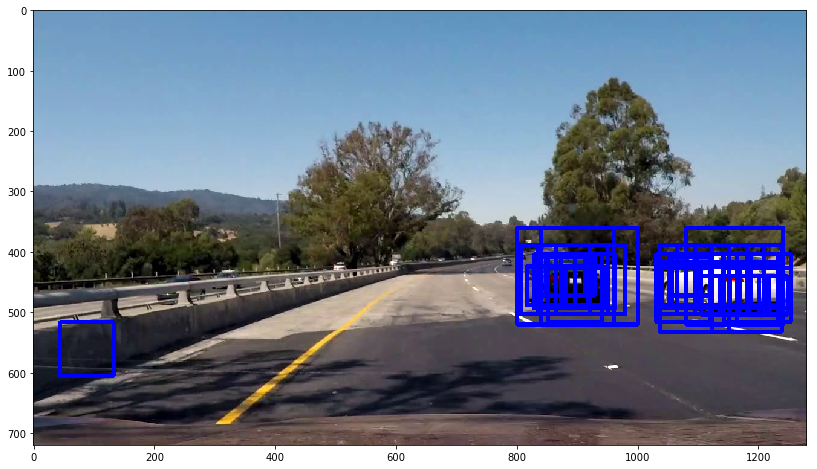

In [501]:
# test for a few frames from test video to adjust 
scan_passes = [(2.5, 360, 720), (1.8, 360, 680),(1.4, 360, 640), (1, 360, 600)]
images = glob.glob('output_images/*.jpg')
test_samples = 25
images = shuffle(images)
images = images[0:test_samples]
for file in images:
    img = cv2.imread(file)
    #img = mpimg.imread(file)
    #img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR )
    draw_image = np.copy(img)
    bbox_list = []
    for scan_pass in scan_passes:
        bboxes = find_cars(img, scan_pass[1], scan_pass[2], 
                                     scan_pass[0], svc, X_scaler, orient, pix_per_cell, cell_per_block, 
                                     spatial_size, hist_bins, 
                                     spatial_feat=use_spatial_feat,
                                     cells_per_step = 1,
                                     hist_feat=use_spatial_feat,
                                     hog_feat=use_hog_feat,
                                     hog_channel=hog_channel,
                                     color_space=colorspace,
                                     vis=False,
                                     scale_normalize=False)
        bbox_list.extend(bboxes)
    draw_image = draw_boxes(draw_image, bbox_list, color=(255, 0, 0))    
    plt.figure(figsize=(16,8))
    plt.imshow(cv2.cvtColor(draw_image, cv2.COLOR_BGR2RGB))
    plt.show()    

In [502]:
scan_passes = [(2.5, 400, 720), (1.8, 400, 680),(1.4, 400, 640), (1, 400, 600)]
heat = None
project_output = 'test_output_sbs.mp4'
clip1 = VideoFileClip('test_video.mp4')
project_clip = clip1.fl_image(process_image)
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video test_output_sbs.mp4
[MoviePy] Writing video test_output_sbs.mp4


 97%|███████████████████████████████████████████████████████████████████████████████▉  | 38/39 [01:10<00:01,  1.98s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_output_sbs.mp4 

Wall time: 1min 11s


In [504]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

### False Positive Filter using heatmap Problem 

 * Bounding Box is not over whole vehicle 
 * Flashing Bounding Box 

The heatmap filter is binary on value so that it might filter out good prediction.  I decide to explore *LinearSVC decision_function* to get confidence scores of predicition.

*** Using LinearSVC decision_function ***

Revise add_cars function will add test score into box list.

In [608]:
def add_heat_score(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += box[2]
        #print(box[2])
    # Return updated heatmap
    return heatmap
use_heatmap_track=True
use_pipeline_vis=True
def process_image2(img, vis=use_pipeline_vis, heat_track=use_heatmap_track, use_heat=use_heat, heatmap_filter=1.5):
    # convert to BGR first
    global heat
    draw_img = np.copy(img)
    
    if vis:
        img_size = (img.shape[1],img.shape[0])
        box_img=np.copy(img)
        
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)    
    bbox_list = []
    for scan_pass in scan_passes:
        bboxes = find_cars(img, scan_pass[1], scan_pass[2], 
                                 scan_pass[0], svc, X_scaler, orient, pix_per_cell, cell_per_block, 
                                 spatial_size, hist_bins, 
                                 spatial_feat=use_spatial_feat,
                                 cells_per_step = 1,
                                 hist_feat=use_spatial_feat,
                                 hog_feat=use_hog_feat,
                                 hog_channel=hog_channel,
                                 color_space=colorspace,
                                 vis=False,
                                 scale_normalize=False)
        bbox_list.extend(bboxes)
    if use_heat:
        # use heatmap for tracking
        if heat_track:
            if heat is None:
                heat = np.zeros_like(img[:, :, 0]).astype(np.float)
                
        heat0 = np.zeros_like(img[:, :, 0]).astype(np.float)

        # Add heat to each box in box list        
        if heat_track:
            heat_trace_coefficient = 0.5
            heat0 = add_heat_score(heat0, bbox_list)
            heat = heat0 * heat_trace_coefficient + (1-heat_trace_coefficient) * heat
        else:
            heat = add_heat_score(heat0, bbox_list)

        # Apply threshold to help remove false positives
        heatmap = apply_threshold(heat, heatmap_filter)

        # Visualize the heatmap when displaying
        heatmap = np.clip(heatmap, 0, 255)

        # Find final boxes from heatmap using label function
        labels = label(heatmap)
        draw_img = draw_labeled_bboxes(draw_img, labels)
    else:
        draw_img = draw_boxes(draw_img, bbox_list, color=(0, 0, 255))
        
    if vis: # add heatmap and boxes images
        cmap = plt.get_cmap('hot')
        # data range is 0 to 1.0 for cmap
        heat_img = cmap(heatmap / np.max(heatmap))
        heat_img = (cv2.resize(heat_img, img_size)[:,:,:3] *255).astype(np.uint8)        
        box_img = draw_boxes(box_img, bbox_list, color=(0, 0, 255))
        new_img = np.concatenate((heat_img, box_img), axis=0)
        new_img = cv2.resize(new_img, (img_size[0]//2, img_size[1]))
        draw_img = np.concatenate((draw_img, new_img), axis=1)
    return draw_img

*** Test Heatmap Score ***

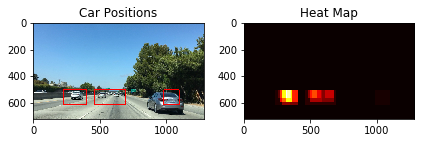

In [592]:
#
# Test Heatmap for false positive and bounding box
#
box_list = pickle.load(open("bbox_pickle.p", "rb"))

# Read in image similar to one shown above
image = cv2.imread('bbox-example-image.jpg')
heat = np.zeros_like(image[:, :, 0]).astype(np.float)

# Add heat to each box in box list
heat = add_heat_score(heat, box_list)

# Apply threshold to help remove false positives
heat = apply_threshold(heat, 0.2)

# Visualize the heatmap when displaying
heatmap = np.clip(heat, 0, 255)

# Find final boxes from heatmap using label function
labels = label(heatmap)
draw_img = draw_labeled_bboxes(np.copy(image), labels)

fig = plt.figure()
plt.subplot(121)
plt.imshow(cv2.cvtColor(draw_img, cv2.COLOR_BGR2RGB))
plt.title('Car Positions')
plt.subplot(122)
#plt.imshow(heatmap, cmap='hot')
# try use cmap to get RGB 
cmap = plt.get_cmap('hot')
# data range is 0 to 1.0 for cmap
plt.imshow(cmap(heatmap / np.max(heatmap)))

plt.title('Heat Map')
fig.tight_layout()
plt.show()

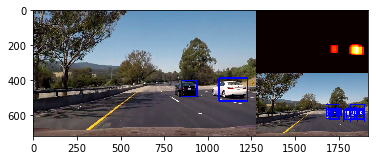

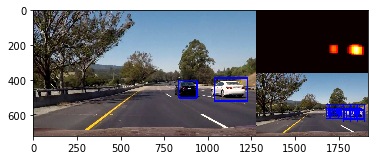

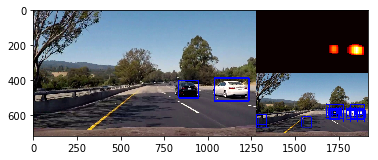

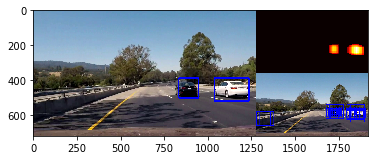

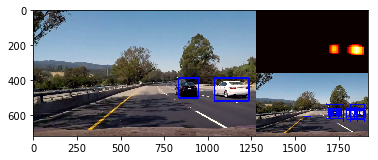

In [604]:
heat=None
scan_passes = [(2.5, 360, 720), (1.8, 360, 680),(1.4, 360, 640), (1, 360, 500)]
images = glob.glob('output_images/*.jpg')
test_samples = 5
images = shuffle(images)
images = images[0:test_samples]
for file in images:
    img = mpimg.imread(file)
    draw_image = process_image2(img,heatmap_filter=1.8) 
    #plt.figure(figsize=(16,8))
    plt.imshow(draw_image)
    plt.show()    

In [605]:
scan_passes = [(2.5, 400, 720), (1.8, 400, 680),(1.4, 400, 640), (1, 400, 600)]
#scan_passes = [(3, 360, 720), (2.5, 360, 720), (1.8, 360, 680),(1.4, 360, 640), (1, 360, 500)]
heat = None
project_output = 'test_output_sbs.mp4'
clip1 = VideoFileClip('test_video.mp4')
project_clip = clip1.fl_image(process_image2)
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video test_output_sbs.mp4
[MoviePy] Writing video test_output_sbs.mp4


 97%|███████████████████████████████████████████████████████████████████████████████▉  | 38/39 [01:10<00:01,  1.83s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_output_sbs.mp4 

Wall time: 1min 11s


In [606]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

### Project Video

In [609]:
heat = None
project_output = 'project_output_sbs.mp4'
clip1 = VideoFileClip('project_video.mp4')
project_clip = clip1.fl_image(process_image2)
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video project_output_sbs.mp4
[MoviePy] Writing video project_output_sbs.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [36:09<00:01,  1.71s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_output_sbs.mp4 

Wall time: 36min 10s


In [610]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

In [611]:
def extract_from_sbs(img):
    return img[:720, :1280,:]

# extract 
project_output = 'p5_output.mp4'
clip1 = VideoFileClip('project_output_sbs.mp4')
project_clip = clip1.fl_image(extract_from_sbs)
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video p5_output.mp4
[MoviePy] Writing video p5_output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [00:36<00:00, 34.82it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: p5_output.mp4 

Wall time: 37.1 s


In [612]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

### Discussion 

 * Image Data Range Problem with HOG function
    
    As described in project tips, mpimg read png file with data in the range 0 to 1.  Since I convert to other color space, 
    the data range should be 0-255. During training process, the hog function throught out exception due to sqrt function call. 
    Looks like still something wrong in the process.  Then I change the read to cv2.imread for png file and no error during
    training and testing.
    
    However, MoviePy get_frame with RGB format.  I need to convert to BGR in the pipeline function. This certainly slow down 
    processing.
      
 * Parameter Selection
 
    I tried to train the data for different feature parameters 
    ```python
    orient_range=[8,9,10,11,12]
    pix_per_cell=[8,12,16]
    ```
    Turned out accuracy all perform very well within 99%. The project use 
    ```python
    colorspace='YCrCb'
    orient=10
    pix_per_cell=16
    ```
    pix_per_cell=16 will reduce the length of feature vector so that maybe performace better in classifier.
    The subsample steps will need to change to 1 because the cell length is now 16.
    
 
 * Time Serial Training Images (Black Car Problem)
    
    At first, the classifier isn't effective enough to recognize back of black cars.  It might be too many similiar
    training images.  
    I use the following method to filter out serial similiar training images.  
    
    1. Compute histogram of current and next images
    2. Compare histogram using correlation method.
    3. If next image is very similiar, it is ignore. 
    
    I can tune to cutoff value to reduce car images from 8000 down to 6000 images for both cars and 
    notcars data set.
    
 * LinearSVC decision_function(X) for confidence score
    
    Instead of using LinearSVC predict(X) function, which one result is 0 or 1, I use decision_function(X) to get the
    score of prediction.  The result is more smooth filtering.
    
 * Bounding Box Smooth with Moving Average
 
    To smooth the bounding box of heat map, previous heat map values are use to compute new heat map. 
    
    ```python    
    heat_trace_coefficient = 0.25
    heat0 = add_heat_score(heat0, bbox_list)
    heat = heat0 * heat_trace_coefficient + (1-heat_trace_coefficient) * heat
    
    ```
    
 